In [66]:
# import relevant libaries 
import pandas as pd
import numpy as np 

# import seaborn and motplotlib for visualizations
import seaborn as sns 
import matplotlib.pyplot as plt 
#import Matplotlib Ticker to style axes of figures
import matplotlib.ticker as ticker

import glob 
from vincenty import vincenty
import datetime
from sklearn.utils import shuffle
from scipy import stats

# imports for geographical visualizations
import geopandas
import json
from h3 import h3
from shapely.geometry import shape
from shapely.geometry import Point
from descartes import PolygonPatch

#imports of folium for map visualization
import folium
from folium import plugins
from folium.plugins import HeatMapWithTime
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
from folium.plugins import DualMap
from folium.plugins import TimestampedGeoJson
from folium import plugins

# import timeit to measure execution times
import timeit

import warnings
warnings.filterwarnings(action='ignore')

### Creating a spatial resolution for Bonn (Hexagons with different edge sizes):

In [67]:
#creates hexagons for the city of Bonn 
#returns geodataframe with h3_hex_ids and geometries of the hexagons
def hexForBonn(resolution=9):
    city_bounding_box = geopandas.read_file('Data/BonnGeoJSON.geojson')
    city_bounding_box_json_string = city_bounding_box.to_json()
    city_bounding_box_json = json.loads(city_bounding_box_json_string)
    city_bounding_box_poly = city_bounding_box_json["features"][0]
    H3_HEXAGON_RESOLUTION = resolution
    polygon_obj = city_bounding_box_poly["geometry"]
    hexagons = h3.polyfill(geo_json = polygon_obj, res = H3_HEXAGON_RESOLUTION, geo_json_conformant = True)
    # Convert H3 Indexes to Geometry Objects
    # Create geo data frame
    df_geos = geopandas.GeoDataFrame(list(hexagons), columns=['h3_hex_id'], crs="EPSG:4326")#contains h3_hex_ids and geometries
    # transform h3 to geo_boundary 
    df_geos['geometry'] = df_geos[(df_geos['h3_hex_id'].notna())].apply(
        lambda row: shape({"type": "Polygon",
                           "coordinates": [h3.h3_to_geo_boundary(h3_address=row["h3_hex_id"], geo_json=True)],
                           "properties": ""
                          }), axis=1)
    df_geos.to_file("data/hex.geojson", driver="GeoJSON") # save hex with specified hex_resolution to use it in choropleth 
    return df_geos

# 1. Visualization of the availability of bikes

In this section we visualize the amount of bikes which are available in Bonn. Furthermore we are looking at different spatio-temporal resolutions.

In [106]:
# read in transformed availability data
availability_data = pd.read_csv("Data/bonn_availability.csv", index_col=0)

In [110]:
availability_data.columns

Index(['Code_18', 'datetime', 'b_number', 'trip', 'p_lat', 'p_lng', 'p_name',
       'available_bikes', 'city', 'month', 'day', 'hour', 'temperature °C',
       'relative_humidity', 'precipitaion_level (mm)', 'precipitation y/n',
       'average_wind_speed (m/s)', 'urban_fabric',
       'discontinuous_urban_fabric', 'continuous_urban_fabric',
       'industry_commercial', 'green_urban_area', 'agricultural_area',
       'forest', 'water_courses', 'distance_next_station'],
      dtype='object')

### Number of available bikes

In [12]:
# Adding hexagons
from h3 import h3 
def createHexagons(df, resolution = 8):    
    df["h3_hex_id"] = df.apply(lambda row: h3.geo_to_h3(row["p_lat"], row["p_lng"], resolution) if (row['p_lat'] and row['p_lng']) else 0, axis=1)
    return df

In [13]:
# Creating a time basket
def get_timebasket(hour):
    #from 5.00 to 10.59 : Morning
    if hour>4 and hour<11:
        x=0
        
    #from 11.00 to 12.59 : noon
    if hour>10 and hour<13:
        x=1
    
    #from 13.00 to 17.59 : afternoon
    if hour>12 and hour<18:
        x=2
    
    #from 18.00 to 22.59 : evening
    if hour>17 and hour<23:
        x=3
    
    #from 23.00 to 4.59 : night
    if hour>22 or hour<5:
        x=4
    return x


### Adding the centers of each hexagon

In [127]:
def centroid(h3hexId):
    vertexes = h3.h3_to_geo_boundary(h3hexId)
    _x_list = [vertex [0] for vertex in vertexes]
    _y_list = [vertex [1] for vertex in vertexes]
    _len = len(vertexes)
    _x = sum(_x_list) / _len
    _y = sum(_y_list) / _len
    return _x, _y

### Creating the dataframe which shows the available bikes per given hexagon resolution and period length

In [128]:
def prepareAvailabilityData(hex_resolution=8, periodLength=6, df=availability_data): 
    """
    periodLength = 24h / 6h / 2h / 1h
    hex_resolution = 5 / 6 / 7 / 8 / 9 
    """
    # creating hexagons with defined hex_resolution
    availability_data = createHexagons(df, hex_resolution)
    
    #Filter for start and end
    trips = ['start', 'end']
    availability_data_start_end = df[df.trip.isin(trips)]
    
    availability_data2=availability_data_start_end.sort_values(['b_number', 'datetime'])
    
    #After checking the amount of end and start trips, we see that there is no even amount of start and end trips 
    #so let's check sequences and eliminate those that do not form a pair
    #it eliminates those where the b_number is the same and the trip type is the same of two following rows
    #and those where the bike number is not the same but the trip type is the same 
    m1 = (availability_data2['b_number'] == availability_data2['b_number'].shift(-1))
    m2 = (availability_data2['trip'] == availability_data2['trip'].shift(-1))
    m3 = (availability_data2['b_number'] != availability_data2['b_number'].shift(-1))
    m4 = (availability_data2['trip'] == availability_data2['trip'].shift(-1))
    availability = availability_data2[~((m1&m2)|(m3&m4))]
    
    # sort dataframe so that we can locate the first occurrence of every bike
    df_firstocc = df.sort_values(['month', 'day', 'hour'])
    
    # first occurence of every bike in 2019
    first_occ_ofallbikes = df_firstocc.loc[df_firstocc.trip =='first'].groupby('b_number').head(1)
    
    frames = [availability, first_occ_ofallbikes]
    
    availability_data_start_end_firstocc= pd.concat(frames)
    
    availability_data_start_end_firstocc2 = availability_data_start_end_firstocc
    
    #Adding column available bikes
    #For arriving trips (trip == 'end') and the first occurrence of every bike (trip == 'first') 1 is written into the new column, because one bike is added in each case. 
    #For starting trips (trip == 'start') 0 is written into the new column, because there is one bike leaving in each case.
    availability_data_start_end_firstocc2['available_bikes']= availability_data_start_end_firstocc2.apply(lambda x: 1 if ((x.trip == 'end')|(x.trip == 'first')) else (-1), axis=1)
    
    #Summing up of the Available bike column with GroupBy to calculate the value of how many bikes come and go per hexagon, month, day and hour .
    grouped_2 = availability_data_start_end_firstocc2[['h3_hex_id','month', 'day', 'hour', 'available_bikes']].groupby(['h3_hex_id','month', 'day', 'hour'], as_index = False).sum()
    
    grouped_2 = grouped_2.sort_values(['month', 'day', 'hour']).groupby('h3_hex_id')
    
    all_groups = []
    for group in grouped_2.groups:
    
        group = grouped_2.get_group(group)
        group = group.reset_index()
        
        # Cumulative summing of the available bikes column per hexagon to get the number of available bikes per hexagon
        group['available_bikes']= np.cumsum(group['available_bikes'])  
    
        all_groups.append(group)

    cumulativesum_df = pd.concat(all_groups)
    
    #saving the unique h3_hex_ids
    h3_hex_ids = cumulativesum_df['h3_hex_id'].unique()
    
    #create new dataframe with the same columns
    all_availability = pd.DataFrame(columns=["h3_hex_id", "datetime", "month","day","hour", "available_bikes"])
    
    #add the unique h3_hex_ids
    all_availability['h3_hex_id'] = h3_hex_ids
    
    #create a time range for the new dataframe starting from the 20/01/2019 as our provided data starts at that time
    datelist = pd.date_range('2019-01-20 00:00:00', '2019-12-31 23:59:00', freq='H').tolist()

    for i in range(0, len(h3_hex_ids)):
        all_availability['datetime'][i] = datelist
    
    s = all_availability.apply(lambda x: pd.Series(x['datetime']),axis=1).stack().reset_index(level=1, drop=True)
    s.name = 'datetime'

    all_availability = all_availability.drop('datetime', axis=1).join(s)
    
    all_availability["datetime"] = pd.to_datetime(all_availability["datetime"])
    all_availability["day"] = all_availability["datetime"].apply(lambda x: x.day)
    all_availability["month"] = all_availability["datetime"].apply(lambda x: x.month)
    all_availability["hour"] = all_availability["datetime"].apply(lambda x: x.hour)
    
    #Merge the grouped original dataframe with the new dataframe
    availability_per_hex = pd.merge(cumulativesum_df, all_availability, left_on=['h3_hex_id', 'month', 'day', 'hour'], right_on=['h3_hex_id', 'month', 'day', 'hour'], how="outer")
    availability_per_hex = availability_per_hex.drop('available_bikes_y', axis=1)
    availability_per_hex = availability_per_hex.rename(columns= {'available_bikes_x': 'available_bikes'})
    
    availability_per_hex_groups = availability_per_hex.sort_values(['h3_hex_id','month', 'day', 'hour']).groupby('h3_hex_id')
    
    all_groups = []
    #split by groups   
    for group in availability_per_hex_groups.groups:
        group = availability_per_hex_groups.get_group(group)
        group = group.reset_index()
               
        #save the dataframe for one hexagon in the list all groups  
        all_groups.append(group)

    availability_per_hex = pd.concat(all_groups)
    
    availability_per_hex = availability_per_hex.drop(['level_0', 'index'], axis=1)
    
    # applying a forward fill per group to add the missing hourly available bikes per hexagon
    availability_per_hour = availability_per_hex.groupby(['h3_hex_id'], as_index=False).apply(lambda group: group.ffill())
    
    # filling the remaining NaN values with 0
    availability_per_hour = availability_per_hour.fillna(0)
    
    # adding column weekday
    availability_per_hour["weekday"] = availability_per_hour["datetime"].dt.dayofweek
    
    # adding new boolean column "weekend"    
    availability_per_hour["weekend"] = availability_per_hour["weekday"].apply(lambda x: isWeekend(x))
    
    # adding the time basket as defined by periodLength
    availability_per_hour['time_basket'] = availability_per_hour['hour'].apply(lambda x: x//periodLength+1)
    
    # adding the coordinates of the center per each hexagon
    availability_per_hour["center"] = availability_per_hour["h3_hex_id"].apply(lambda x: centroid(x))
    availability_per_hour["center_x"] = availability_per_hour["center"].apply(lambda x: x[0])
    availability_per_hour["center_y"]  = availability_per_hour["center"].apply(lambda x: x[1])
    
    # calculating the mean of the availabe bikes per hexagon, month, day and time basket
    availability_per_hour = availability_per_hour.groupby(['h3_hex_id', 'center', 'center_x', 'center_y', 'month', 'day', 'weekday','time_basket' ], as_index=False).mean()
    
    # drop duplicate rows which have been created by mistake
    df_availability = availability_per_hour.drop_duplicates()
    
    return df_availability
    

### Creating a choropleth visualizing the available bikes per hexagon, day and month

In [201]:
# returns a choropleth showing the number of available bikes per hexagon 
# parameter: resolution = vary the size of hexagons 
#            day, month, hour: specify the datetime 

def choropleth_available_bikes_per_hex(day, month, resolution, df): 
    # create hexagons for bonn with specified resolution 
    df_geos = hexForBonn(resolution=resolution)
    
    df = df[(df['month'] == month) & (df['day'] == day)]
    
    # add geometry column again and save the file as GeoJSON
    df_geo = df.merge(df_geos, on='h3_hex_id')
    df_geo = df_geo[['h3_hex_id', 'available_bikes', 'geometry']]
    df_geo = df_geo.drop_duplicates()
    df_geo = geopandas.GeoDataFrame(df_geo)
    df_geo.to_file('data/available_bikes_geo.geojson', driver='GeoJSON')
    
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11, min_zoom=10.5, max_zoom=16)
    folium.Choropleth(geo_data="data/hex.geojson",   # display all hexagons 
                        data=df,           # df with available bikes per hex
                        columns=["h3_hex_id","available_bikes"],
                        key_on="properties.h3_hex_id", # key of the data and geodata is the hex id 
                        fill_color='Reds',
                        fill_opacity=0.7,
                        line_opacity=0.5,
                        line_weight=1,
                        line_color='black',
                        legend_name='Number of available bikes per hexagon',
                        bins=7
                    ).add_to(m) 
    
    # show available bikes per hexagon by adding a GeoJsonTooltip
    folium.GeoJson('data/available_bikes_geo.geojson',
                  style_function = lambda feature:{'color': 'black', 'weight':0.01, 'fillOpacity': 0.01},
                  highlight_function = lambda x: {'weight': 2, 'color':'black', 'fillOpacity': 0.5},
                  tooltip=folium.features.GeoJsonTooltip(fields=['h3_hex_id', 'available_bikes'], aliases=['Hexagon ID:', 'Available bikes:'])
                  ).add_to(m)
    
    #mark University of Bonn
    folium.Marker([50.72745325515178, 7.085836360350935], popup='<b>University of Bonn</b>', icon=folium.Icon(color='blue')).add_to(m)
    
    #mark Bonn central station
    folium.Marker([50.732360, 7.097010], popup='<b>Bonn central station</b>', icon=folium.Icon(color='green')).add_to(m)
    
    return m 

### Hexagon resolution 6

In [191]:
# creating the daily average availability per hexagon (resolution = 6), month and day
df_availability = prepareAvailabilityData(hex_resolution=6,periodLength=24,df=availability_data)

In [193]:
df_availability

,h3_hex_id,center,center_x,center_y,month,day,weekday,time_basket,hour,available_bikes,weekend
0,861fa1037ffffff,"(50.673831482252105, 7.227958646427965)",50.673831,7.227959,1,20,6,1,11.5,10.250000,1.0
1,861fa1037ffffff,"(50.673831482252105, 7.227958646427965)",50.673831,7.227959,1,21,0,1,11.5,10.500000,0.0
2,861fa1037ffffff,"(50.673831482252105, 7.227958646427965)",50.673831,7.227959,1,22,1,1,11.5,9.375000,0.0
3,861fa1037ffffff,"(50.673831482252105, 7.227958646427965)",50.673831,7.227959,1,23,2,1,11.5,8.333333,0.0
4,861fa1037ffffff,"(50.673831482252105, 7.227958646427965)",50.673831,7.227959,1,24,3,1,11.5,9.166667,0.0
...,...,...,...,...,...,...,...,...,...,...,...
3801,861fa1c4fffffff,"(50.73891623270483, 7.031519534543524)",50.738916,7.031520,12,27,4,1,11.5,657.666667,0.0
3802,861fa1c4fffffff,"(50.73891623270483, 7.031519534543524)",50.738916,7.031520,12,28,5,1,11.5,650.750000,1.0
3803,861fa1c4fffffff,"(50.73891623270483, 7.031519534543524)",50.738916,7.031520,12,29,6,1,11.5,651.541667,1.0
3804,861fa1c4fffffff,"(50.73891623270483, 7.031519534543524)",50.738916,7.031520,12,30,0,1,11.5,655.291667,0.0


In [204]:
# displays the number of available bikes on 01.04.2019
# size of hexagons is 6 
m = choropleth_available_bikes_per_hex(day=21,month=1, resolution=6, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 21st of January</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon6_01_21.html')

m

In [202]:
# displays the number of available bikes on 01.04.2019
# size of hexagons is 6 
m = choropleth_available_bikes_per_hex(day=1,month=4, resolution=6, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of April</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon6_04_01.html')

m

In [205]:
# displays the number of available bikes on 01.07.2019
# size of hexagons is 6 
m = choropleth_available_bikes_per_hex(day=1,month=7, resolution=6, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of July</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon6_07_01.html')
m

In [206]:
# displays the number of available bikes on 01.12.2019
# size of hexagons is 6 
m = choropleth_available_bikes_per_hex(day=1,month=12, resolution=6, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of December</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon6_12_01.html')
m

### Hexagon resolution 7

In [207]:
# creating the daily average availability per hexagon (resolution = 7), month and day
df_availability = prepareAvailabilityData(hex_resolution=7,periodLength=24,df=availability_data)

In [213]:
df_availability

,h3_hex_id,center,center_x,center_y,month,day,weekday,time_basket,hour,available_bikes,weekend
0,871fa1032ffffff,"(50.65461869788869, 7.214118833734157)",50.654619,7.214119,1,20,6,1,11.5,0.000000,1.0
1,871fa1032ffffff,"(50.65461869788869, 7.214118833734157)",50.654619,7.214119,1,21,0,1,11.5,0.000000,0.0
2,871fa1032ffffff,"(50.65461869788869, 7.214118833734157)",50.654619,7.214119,1,22,1,1,11.5,0.000000,0.0
3,871fa1032ffffff,"(50.65461869788869, 7.214118833734157)",50.654619,7.214119,1,23,2,1,11.5,0.000000,0.0
4,871fa1032ffffff,"(50.65461869788869, 7.214118833734157)",50.654619,7.214119,1,24,3,1,11.5,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...
13835,871fa1c4dffffff,"(50.758136109063116, 7.0453021632135675)",50.758136,7.045302,12,27,4,1,11.5,305.750000,0.0
13836,871fa1c4dffffff,"(50.758136109063116, 7.0453021632135675)",50.758136,7.045302,12,28,5,1,11.5,303.666667,1.0
13837,871fa1c4dffffff,"(50.758136109063116, 7.0453021632135675)",50.758136,7.045302,12,29,6,1,11.5,306.875000,1.0
13838,871fa1c4dffffff,"(50.758136109063116, 7.0453021632135675)",50.758136,7.045302,12,30,0,1,11.5,307.500000,0.0


In [214]:
# displays the number of available bikes on 21.01.2019 
# size of hexagons is 7
m = choropleth_available_bikes_per_hex(day=21,month=1,resolution=7, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 21st of January</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon7_01_21.html')
m

In [215]:
# displays the number of available bikes on 01.04.2019 
# size of hexagons is 7
m = choropleth_available_bikes_per_hex(day=1,month=4,resolution=7, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of April</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon7_04_01.html')
m

In [216]:
# displays the number of available bikes on 01.07.2019 
# size of hexagons is 7
m = choropleth_available_bikes_per_hex(day=1,month=7,resolution=7, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of July</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon7_07_01.html')
m

In [217]:
# displays the number of available bikes on 01.12.2019 
# size of hexagons is 7
m = choropleth_available_bikes_per_hex(day=1,month=4,resolution=7, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of December</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon7_12_01.html')
m

### Hexagon resolution 8

In [218]:
# creating the daily average availability per hexagon (resolution = 8), month and day
df_availability = prepareAvailabilityData(hex_resolution=8,periodLength=24,df=availability_data)

In [219]:
# displays the number of available bikes on 21.01.2019 
# size of hexagons is 8
m = choropleth_available_bikes_per_hex(day=21,month=1,resolution=8, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 21st of January</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon8_01_21.html')
m

In [220]:
# displays the number of available bikes on 01.04.2019 
# size of hexagons is 8
m = choropleth_available_bikes_per_hex(day=1,month=4,resolution=8, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of April</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon8_04_01.html')
m

In [221]:
# displays the number of available bikes on 01.07.2019 
# size of hexagons is 8
m = choropleth_available_bikes_per_hex(day=1,month=7,resolution=8, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of July</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon8_07_01.html')
m

In [222]:
# displays the number of available bikes on 01.12.2019 
# size of hexagons is 8
m = choropleth_available_bikes_per_hex(day=1,month=4,resolution=8, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of December</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon8_12_01.html')
m

### Hexagon resolution 9

In [223]:
# creating the daily average availability per hexagon (resolution = 9), month and day
df_availability = prepareAvailabilityData(hex_resolution=9,periodLength=24,df=availability_data)

In [224]:
# displays the number of available bikes on 21.01.2019 
# size of hexagons is 9
m = choropleth_available_bikes_per_hex(day=21,month=1,resolution=9, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 21st of January</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon9_01_21.html')
m

In [225]:
# displays the number of available bikes on 01.04.2019 
# size of hexagons is 9
m = choropleth_available_bikes_per_hex(day=1,month=4,resolution=9, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of April</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon9_04_01.html')
m

In [226]:
# displays the number of available bikes on 01.07.2019 
# size of hexagons is 9
choropleth_available_bikes_per_hex(day=1,month=7,resolution=9, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of July</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon9_07_01.html')
m

In [227]:
# displays the number of available bikes on 01.12.2019 
# size of hexagons is 9
choropleth_available_bikes_per_hex(day=1,month=4,resolution=9, df=df_availability)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average amount of available bikes on the 1st of December</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/available_bikes_hexagon9_12_01.html')
m

# 2. Visualization of the trips

In this section we visualize different characteristics of the trips, like the start time, the trip duration, the idle time between trips and the start and end locations.

In [228]:
# Reading in the trip data
trips = pd.read_csv("Data/bonn_trips.csv",index_col=0)

## Start time of the trips

Are there any visible differences of the start time regarding months, days of the week, and the different areas of Bonn (represented by equally sized hexagons)?

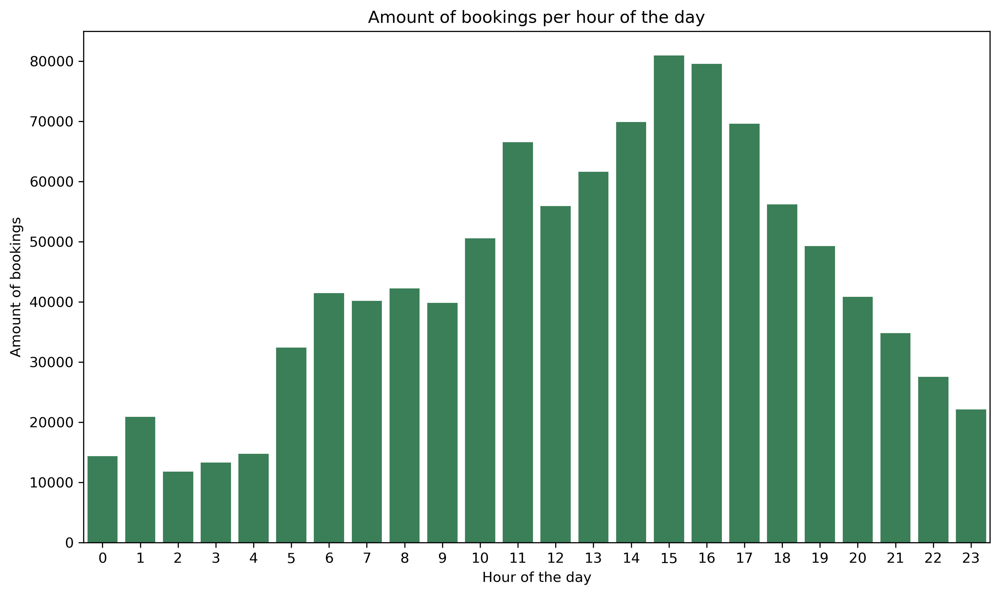

In [367]:
#plotting the amount of bookings per hour of the day

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10,6), dpi=300)
sns.countplot(trips['hour'], ax=ax, color='seagreen')

ax.set_ylabel('Amount of bookings')
ax.set_xlabel('Hour of the day')
ax.set_title("Amount of bookings per hour of the day")
fig.tight_layout()

plt.savefig('Data/Visualizations/Bookings_per_hour.png')
plt.show()

### Start time per day of the week

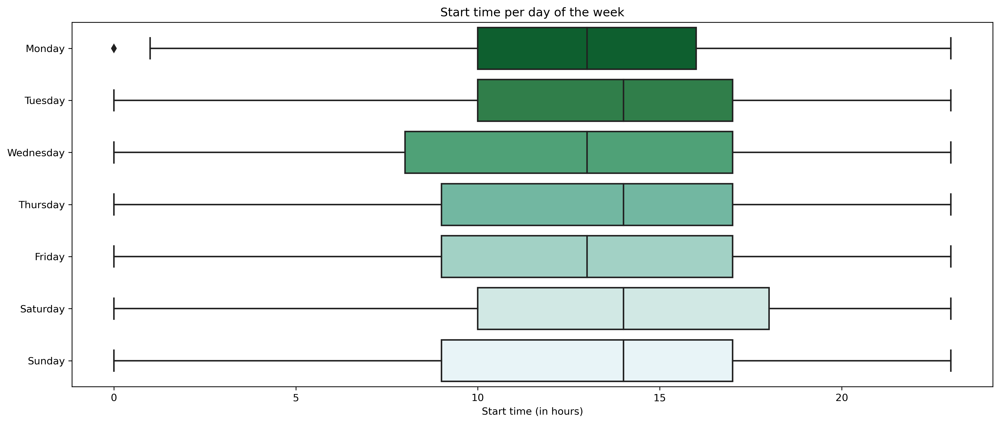

In [447]:
#Visualisation of the quartiles, medians and outliers of the start time per weekday

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14,6), dpi=300)
sns.boxplot(y="weekday", x="hour", data=trips, ax=ax, palette="BuGn_r", orient="h")

days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
ax.set_yticklabels(days)
ax.set_xlabel("Start time (in hours)")
ax.set_ylabel("")
ax.set_title('Start time per day of the week')
fig.tight_layout()

plt.savefig('Data/Visualizations/Start_time_weekday.png')
plt.show()

### Start time per month

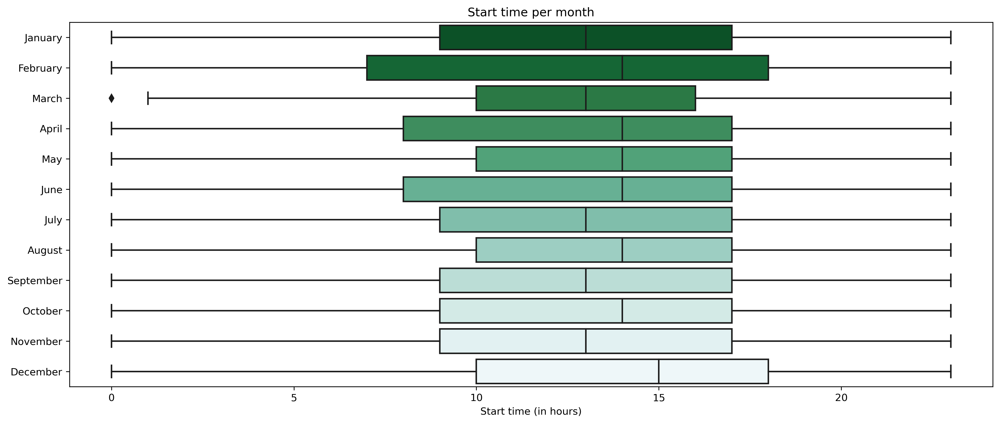

In [446]:
#Visualisation of the quartiles, medians and outliers of the start time per month

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14,6), dpi=300)
sns.boxplot(y="month", x="hour", data=trips, ax=ax, palette="BuGn_r", orient="h")

months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
ax.set_yticklabels(months)
ax.set_xlabel("Start time (in hours)")
ax.set_ylabel("")
ax.set_title("Start time per month")

fig.tight_layout()

plt.savefig('Data/Visualizations/Start_time_month.png')
plt.show()

### Start time per Weekend or Weekdays

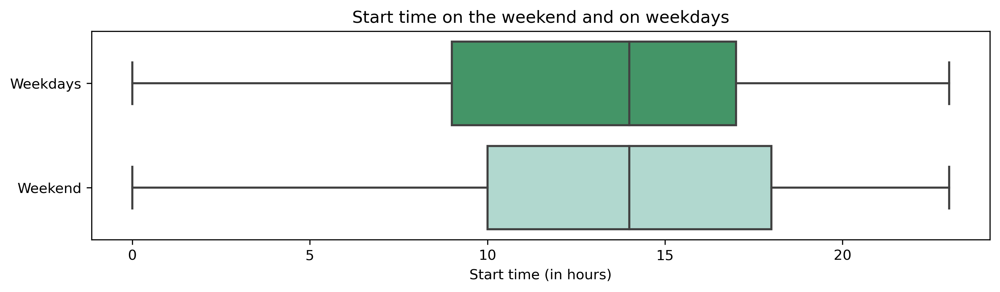

In [445]:
#Comparing start time when it is weekend to when it is not the weekend

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10,3), dpi=300)
sns.boxplot(y="weekend", x="hour", data=trips, ax=ax, palette="BuGn_r", orient="h")

labels=["Weekdays","Weekend"]
ax.set_yticklabels(labels)
ax.set_ylabel("")
ax.set_xlabel("Start time (in hours)")
ax.set_title('Start time on the weekend and on weekdays')

fig.tight_layout()

plt.savefig('Data/Visualizations/Start_time_weekend.png')
plt.show()

### Mode of the start time per Hexagons
We decided to look at the mode of the start time, as the average can easily be distorted by outliers and the mode is more informative in this case.

In [241]:
def mode_start_time_in_hex(data, resolution=9): 
    
    # creating geodataframe of our dataframe   
    geometry = [Point(xy) for xy in zip(data['longitude_start'], data['latitude_start'])]
    gdf_trips = geopandas.GeoDataFrame(data, crs='epsg:4326', geometry=geometry)
    gdf_trips.drop('index_right', inplace=True, axis=1)
    
    # join with hexagons 
    df_geos = hexForBonn(resolution=resolution) #create hexagons for bonn 
    gdf_trips_per_location = geopandas.sjoin(df_geos, gdf_trips, how='inner', op='contains')
    gdf_trips_per_location.reset_index(inplace=True)
    gdf_trips_per_location = gdf_trips_per_location.rename(columns={'h3_hex_id_left': 'h3_hex_id'})
    
    # group by hex_id and calculate the mode of the start time per hexagons
    # we chose mode as it seemed most appropriate for the starting hour
    gdf_start_time_per_location = gdf_trips_per_location.groupby("h3_hex_id").agg(lambda x: stats.mode(x['hour'])[0])
    gdf_start_time_per_location = gdf_start_time_per_location.reset_index()
    gdf_start_time_per_location = gdf_start_time_per_location[['h3_hex_id', 'hour']]
    
    # add geometry column again and save the file as GeoJSON
    # this is necessary as we need a GeoJSON file for the GeoJsonTooltip function later on
    gdf_start_time_per_location_geo = gdf_start_time_per_location.merge(gdf_trips_per_location, on='h3_hex_id')
    gdf_start_time_per_location_geo = gdf_start_time_per_location_geo[['h3_hex_id', 'hour_x', 'geometry']]
    gdf_start_time_per_location_geo = gdf_start_time_per_location_geo.drop_duplicates()
    gdf_start_time_per_location_geo = geopandas.GeoDataFrame(gdf_start_time_per_location_geo)
    gdf_start_time_per_location_geo.to_file('data/start_geo.geojson', driver='GeoJSON')
    
    # returns 2 geodataframe (hexagons for bonn / mode start time per hexagon)
    return df_geos, gdf_start_time_per_location

# returns choropleth with GeoJsonTooltip function
def choropleth_mode_start_time_per_hex(data, hex_resolution=8):
    df_geos, trips= mode_start_time_in_hex(data, hex_resolution) # calls functions above 
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11.2,min_zoom=10)
   
    folium.Choropleth(geo_data="data/hex.geojson",
                      data=trips,
                      columns=["h3_hex_id","hour"],
                      key_on="properties.h3_hex_id",
                      fill_color='Reds',
                      fill_opacity=0.7,
                      line_opacity=0.5,
                      line_weight=1,
                      line_color='black',
                      legend_name='Mode start time per hexagon').add_to(m) 
    
    # show mode start time per hexagon by adding a GeoJsonTooltip
    folium.GeoJson('data/start_geo.geojson',
                  style_function = lambda feature:{'color': 'black', 'weight':0.01, 'fillOpacity': 0.01},
                  highlight_function = lambda x: {'weight': 2, 'color':'black', 'fillOpacity': 0.5},
                  tooltip=folium.features.GeoJsonTooltip(fields=['h3_hex_id', 'hour_x'], aliases=['Hexagon ID:', 'Mode of the starting hour:'])
                  ).add_to(m)
    
    return m 


In [244]:
m = choropleth_mode_start_time_per_hex(trips, hex_resolution = 7)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring start time per hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_hexagon7.html')
m

In [242]:
m = choropleth_mode_start_time_per_hex(trips, hex_resolution = 8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring start time per hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_hexagon8.html')
m

In [245]:
m = choropleth_mode_start_time_per_hex(trips, hex_resolution = 9)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring start time per hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_hexagon9.html')
m

#### Comparison of the mode of the start time on Mondays and Sundays

###### Mondays:

In [246]:
# Creating a dataframe for the bookings made on a Monday
trips_mon = trips[trips['weekday'] == 0]

In [252]:
m = choropleth_mode_start_time_per_hex(trips_mon, hex_resolution=7)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring Start Time per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_monday_hexagon7.html')
m

In [251]:
m = choropleth_mode_start_time_per_hex(trips_mon, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring Start Time on Mondays per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_monday_hexagon8.html')
m

In [249]:
m = choropleth_mode_start_time_per_hex(trips_mon, hex_resolution=9)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring Start Time on Mondays per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_monday_hexagon9.html')
m

##### Sundays:

In [253]:
# Creating a dataframe for the bookings made on a Sunday
trips_sun = trips[trips['weekday'] == 6]

In [254]:
m = choropleth_mode_start_time_per_hex(trips_sun, hex_resolution=7)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring Start Time on Sundays per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_sunday_hexagon7.html')
m

In [255]:
m = choropleth_mode_start_time_per_hex(trips_sun, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring Start Time on Sundays per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_sunday_hexagon8.html')
m

In [256]:
m = choropleth_mode_start_time_per_hex(trips_sun, hex_resolution=9)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>The most occurring Start Time on Sundays per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Start_time_sunday_hexagon9.html')
m

## Trip duration in minutes

Are there any visible differences of the the trip duration regarding the months, the days of the week or the geographical areas of Bonn?

In [257]:
trips['trip_duration'].describe()

count    1.036662e+06
mean     1.204024e+01
std      2.942761e+01
min      2.000000e+00
25%      4.000000e+00
50%      7.000000e+00
75%      1.200000e+01
max      1.376000e+03
Name: trip_duration, dtype: float64

In [258]:
trips['trip_duration'].max()

1376

In [259]:
trips['trip_duration'].min()

2

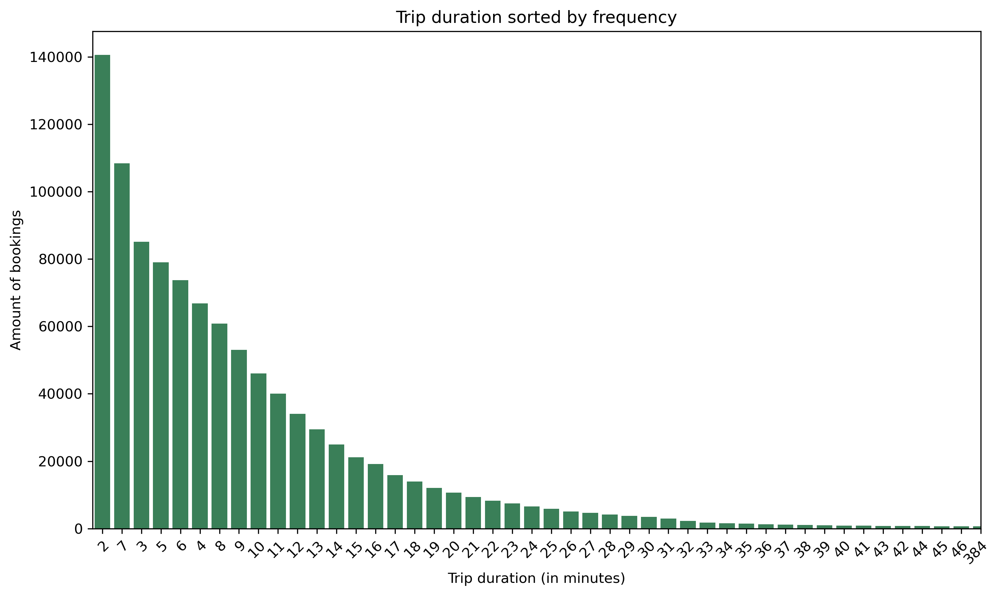

In [261]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 6), dpi=300)
sns.countplot(trips['trip_duration'], order=trips['trip_duration'].value_counts().index, ax=ax, color='seagreen')

ax.set_ylabel('Amount of bookings')
ax.set_xlabel('Trip duration (in minutes)')
ax.set_title("Trip duration sorted by frequency")
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.xlim(-0.5, 45)
fig.tight_layout()

plt.savefig('Data/Visualizations/Trip_duration_frequency.png')
plt.show()

### Trip duration per month

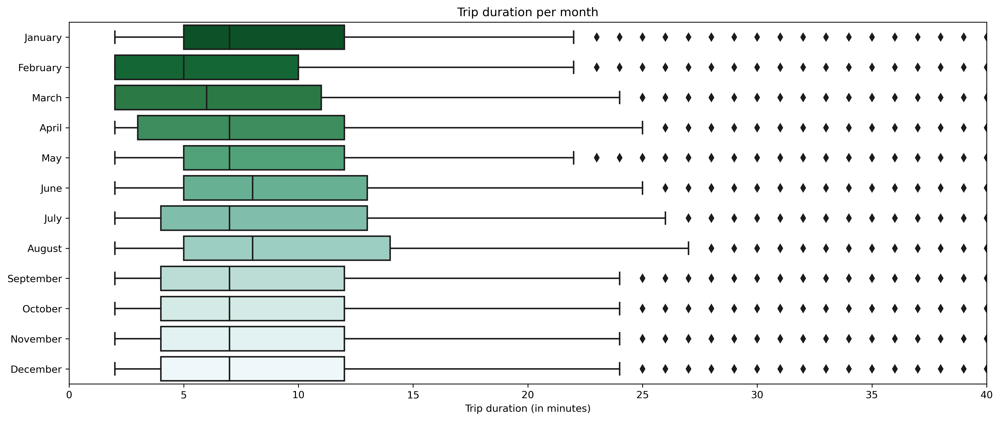

In [378]:
#Visualisation of the quartiles, medians and outliers of the trip duration in minutes of the different months
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14,6), dpi=300)
sns.boxplot(y="month", x="trip_duration", data=trips, ax=ax, palette="BuGn_r", orient="h")

months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
ax.set_yticklabels(months)
ax.set_xlabel("Trip duration (in minutes)")
ax.set_ylabel("")
ax.set_title('Trip duration per month')

fig.tight_layout()

plt.xlim(0,40)
plt.savefig('Data/Visualizations/Trip_duration_months.png')
plt.show()

### Trip duration per day of the week

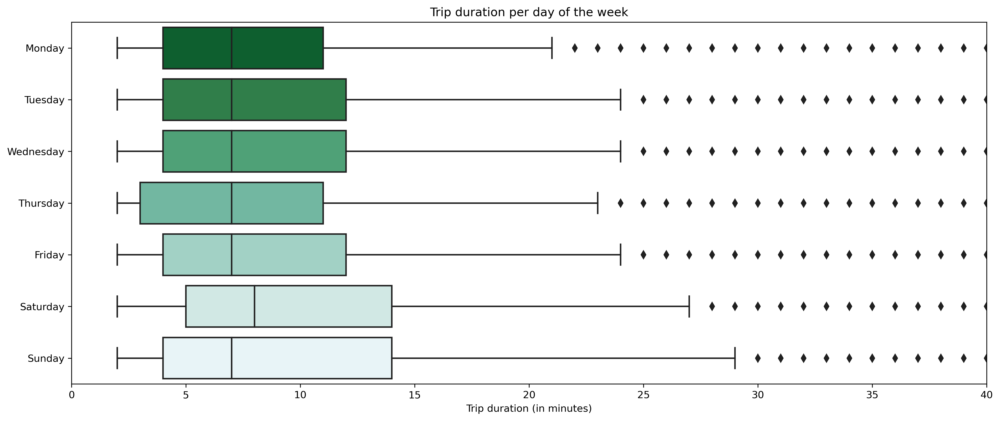

In [379]:
#Visualisation of the quartiles, medians and outliers of the trip duration of the different days of the week
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14,6), dpi=300)
sns.boxplot(y="weekday", x="trip_duration", data=trips, ax=ax, palette="BuGn_r", orient="h")

days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
ax.set_yticklabels(days)
ax.set_xlabel("Trip duration (in minutes)")
ax.set_ylabel("")
ax.set_title('Trip duration per day of the week')

fig.tight_layout()

plt.xlim(0,40)
plt.savefig('Data/Visualizations/Trip_duration_weekdays.png')
plt.show()

### Trip duration per weekdays or the weekend

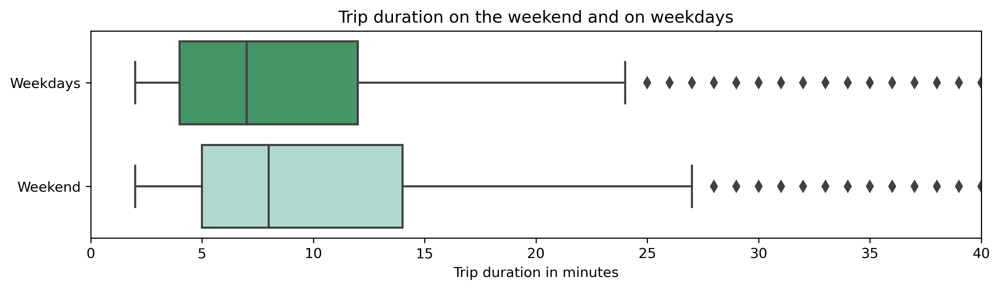

In [448]:
#Comparing trip lengths when it is weekend to when it is not the weekend

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10,3), dpi=300)
sns.boxplot(y="weekend", x="trip_duration", data=trips, ax=ax, palette="BuGn_r", orient="h")

labels=["Weekdays","Weekend"]
ax.set_yticklabels(labels)
ax.set_ylabel("")
ax.set_xlabel("Trip duration in minutes")
ax.set_title('Trip duration on the weekend and on weekdays')

fig.tight_layout()

plt.xlim(0,40)
plt.savefig('Data/Visualizations/Trip_duration_weekend.png')
plt.show()

### Average trip duration per Hexagons

In [268]:
def mean_trip_duration_in_hex(data, resolution=9): 
    
    # creating geodataframe of trips_per_station    
    geometry = [Point(xy) for xy in zip(data['longitude_start'], data['latitude_start'])]
    gdf_trips = geopandas.GeoDataFrame(data, crs='epsg:4326', geometry=geometry)
    gdf_trips.drop('index_right', inplace=True, axis=1)
    
    # join with hexagons 
    df_geos = hexForBonn(resolution=resolution) #create hexagons for bonn 
    
    gdf_trips_per_location = geopandas.sjoin(df_geos, gdf_trips, how='inner', op='contains')
    gdf_trips_per_location.reset_index(inplace=True)
    gdf_trips_per_location = gdf_trips_per_location.rename(columns={'h3_hex_id_left': 'h3_hex_id'})
    
    # group by hex_id and count the mean of the trip duration per hexagons
    gdf_trip_length_per_location = gdf_trips_per_location.groupby("h3_hex_id").mean().reset_index()
    gdf_trip_length_per_location = gdf_trip_length_per_location[['h3_hex_id', 'trip_duration']]
    
    # add geometry column again and save the file as GeoJSON
    gdf_trip_length_per_location_geo = gdf_trip_length_per_location.merge(gdf_trips_per_location, on='h3_hex_id')
    gdf_trip_length_per_location_geo = gdf_trip_length_per_location_geo[['h3_hex_id', 'trip_duration_x', 'geometry']]
    gdf_trip_length_per_location_geo = gdf_trip_length_per_location_geo.drop_duplicates()
    gdf_trip_length_per_location_geo['trip_duration_x'] = round(gdf_trip_length_per_location_geo['trip_duration_x'],2)
    gdf_trip_length_per_location_geo = geopandas.GeoDataFrame(gdf_trip_length_per_location_geo)
    gdf_trip_length_per_location_geo.to_file('data/trip_length_geo.geojson', driver='GeoJSON')
    
    # returns 2 geodataframe (hexagons for bonn / trip lenth per hexagons)
    return df_geos, gdf_trip_length_per_location

# returns choropleth 
def choropleth_mean_trip_duration_per_hex(data, hex_resolution=8):
    df_geos, trips = mean_trip_duration_in_hex(data, hex_resolution) # calls functions above 
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11.2,min_zoom=10)
    folium.Choropleth(geo_data="data/hex.geojson",
                      data=trips,
                      columns=["h3_hex_id","trip_duration"],
                      key_on="properties.h3_hex_id",
                      fill_color='Reds',
                      fill_opacity=0.7,
                      line_opacity=0.5,
                      line_weight=1,
                      line_color='black',
                      legend_name='Mean trip duration per hexagon').add_to(m)    
    
    # show mean trip length per hexagon by adding a GeoJsonTooltip
    folium.GeoJson('data/trip_length_geo.geojson',
                  style_function = lambda feature:{'color': 'black', 'weight':0.01, 'fillOpacity': 0.01},
                  highlight_function = lambda x: {'weight': 2, 'color':'black', 'fillOpacity': 0.5},
                  tooltip=folium.features.GeoJsonTooltip(fields=['h3_hex_id', 'trip_duration_x'], aliases=['Hexagon ID:', 'Mean of the trip duration in minutes:'])
                  ).add_to(m)
    
    
    return m 


In [454]:
#Average trip length of Hexagon resolution 7
m = choropleth_mean_trip_duration_per_hex(trips, hex_resolution=7)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_hexagon7.html')
m

In [455]:
#Average trip length of Hexagon resolution 8
m = choropleth_mean_trip_duration_per_hex(trips, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_hexagon8.html')
m

In [456]:
#Average trip length of Hexagon resolution 9
m = choropleth_mean_trip_duration_per_hex(trips, hex_resolution=9)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_hexagon9.html')
m

##### Comparison of the average trip duration in Summer and Winter

In [274]:
trips_jun = trips[trips['month'] == 6]

In [275]:
trips_dec = trips[trips['month'] == 12]

In [457]:
#Average trip lengths in June
m = choropleth_mean_trip_duration_per_hex(trips_jun, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started in June in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_June_hexagon8.html')
m

In [458]:
#Average trip length in December
m = choropleth_mean_trip_duration_per_hex(trips_dec, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started in December in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_December_hexagon8.html')
m

##### Comparison of the trip duration on Mondays, Sundays and Saturdays

In [459]:
#Average trip lenghts on Mondays
m = choropleth_mean_trip_duration_per_hex(trips_mon, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started on Mondays in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_monday_hexagon8.html')
m

In [460]:
#Average trip lengths on Sundays
m = choropleth_mean_trip_duration_per_hex(trips_sun, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started on Sundays in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_Sunday_hexagon8.html')
m

In [461]:
#filtering for trips on Saturdays
trips_sat=trips[trips['weekday'] == 5]

In [462]:
#Average trip lengths on Saturdays
m = choropleth_mean_trip_duration_per_hex(trips_sat, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started on Saturdays in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_saturday_hexagon8.html')
m

##### Comparison of the trip duration on Monday or Sunday in Summer or Winter

Mondays in Summer:

In [463]:
#Average trip lengths on Mondays in June
trips_mon_06 = trips[(trips['month'] == 6) & (trips['weekday'] == 0)]
m = choropleth_mean_trip_duration_per_hex(trips_mon_06, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started on Mondays in June in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_June_Monday_hexagon8.html')
m

Mondays in Winter:

In [464]:
#Average trip lengths on Mondays in December
trips_mon_12 = trips[(trips['month'] == 12) & (trips['weekday'] == 0)]
m = choropleth_mean_trip_duration_per_hex(trips_mon_12, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started on Mondays in December in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_December_Monday_hexagon8.html')
m

Sundays in Summer:

In [465]:
#Average trip lengths on Sundays in June
trips_sun_06 = trips[(trips['month'] == 6) & (trips['weekday'] == 6)]
m = choropleth_mean_trip_duration_per_hex(trips_sun_06, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started on Sundays in June in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_June_Sunday_hexagon8.html')
m

Sundays in Winter:

In [466]:
#Average trip lengths on Sundays in December
trips_sun_12 = trips[(trips['month'] == 12) & (trips['weekday'] == 6)]
m = choropleth_mean_trip_duration_per_hex(trips_sun_12, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Duration of Trips started on Sundays in December in the respective Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Trip_duration_December_Sunday_hexagon8.html')
m

## 2.3 Idle times between trips

In this section we visualize for how long the bicycles are unused at a place on average and examine this for spatial and temporal differences. Therefore, we visualize the average idle time per month, day of the week, weekday or weekend and per different sized hexagonal sections of Bonn. 

### Average idle times per month

In [288]:
idle_time_month = trips.groupby('month', as_index=False)['idle_time'].mean()

In [289]:
idle_time_month

,month,idle_time
0,1,790.755203
1,2,376.375993
2,3,564.733968
3,4,351.254207
4,5,390.504832
5,6,280.636739
6,7,312.145130
7,8,324.853015
8,9,308.375221
9,10,358.654801


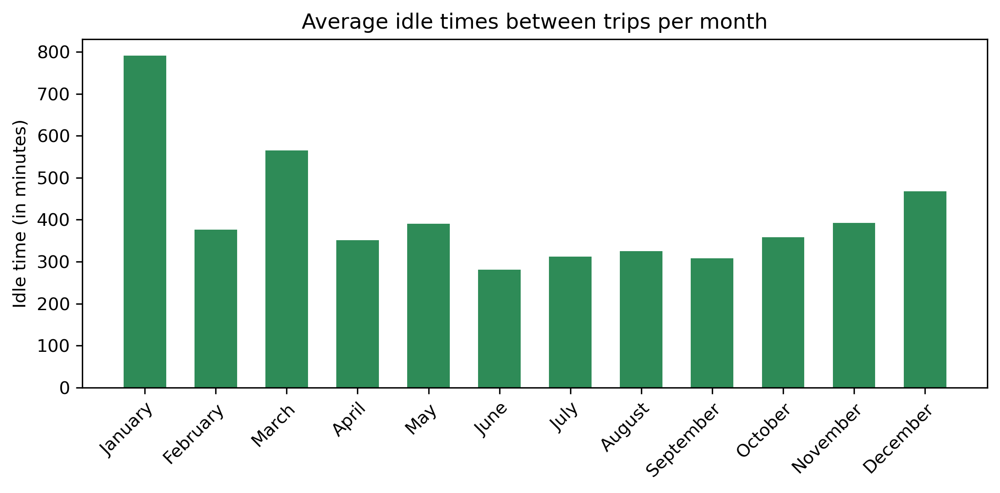

In [444]:
#plotting the average idle time per month
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,4), dpi=300)

months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

ax.bar(months,idle_time_month['idle_time'], width=0.6, color='seagreen')

ax.set_xlabel('')
ax.set_ylabel('Idle time (in minutes)')
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
ax.set_title('Average idle times between trips per month')

fig.tight_layout()

plt.savefig('Data/Visualizations/idle_times_month.png')
plt.show()

### Average idle times per day of the week

In [292]:
idle_time_day = trips.groupby('weekday', as_index=False)['idle_time'].mean()

In [293]:
idle_time_day

,weekday,idle_time
0,0,342.996293
1,1,346.540710
2,2,327.943376
3,3,359.126250
4,4,346.331870
5,5,391.966421
6,6,482.213131


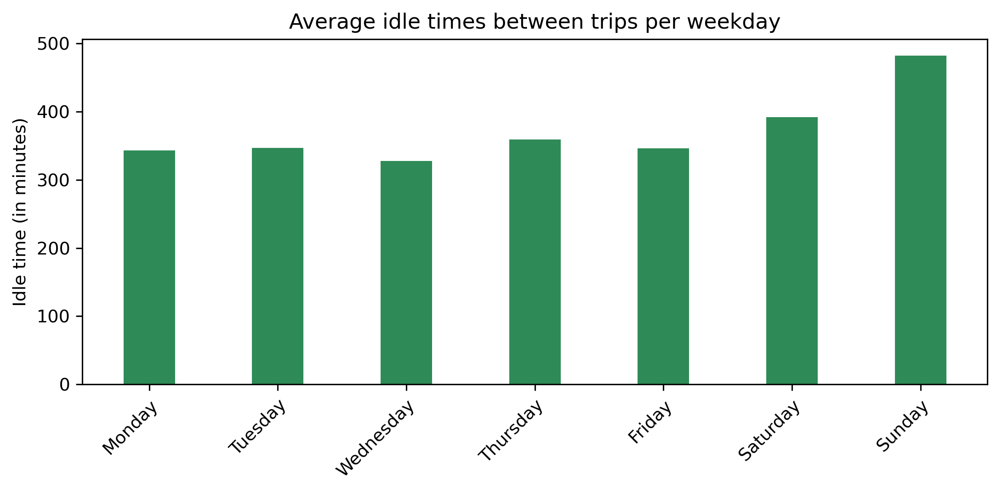

In [443]:
#plotting the average idle time per weekday
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,4), dpi=300)

day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
ax.bar(day_names,idle_time_day['idle_time'], width=0.4, color='seagreen')

ax.set_xlabel('')
ax.set_ylabel('Idle time (in minutes)')
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
ax.set_title('Average idle times between trips per weekday')

fig.tight_layout()

plt.savefig('Data/Visualizations/idle_times_weekday.png')
plt.show()

### Average idle times per Weekday or Weekend

In [295]:
idle_time_weekend = trips.groupby('weekend', as_index=False)['idle_time'].mean()

In [296]:
idle_time_weekend

,weekend,idle_time
0,0,344.854031
1,1,433.324033


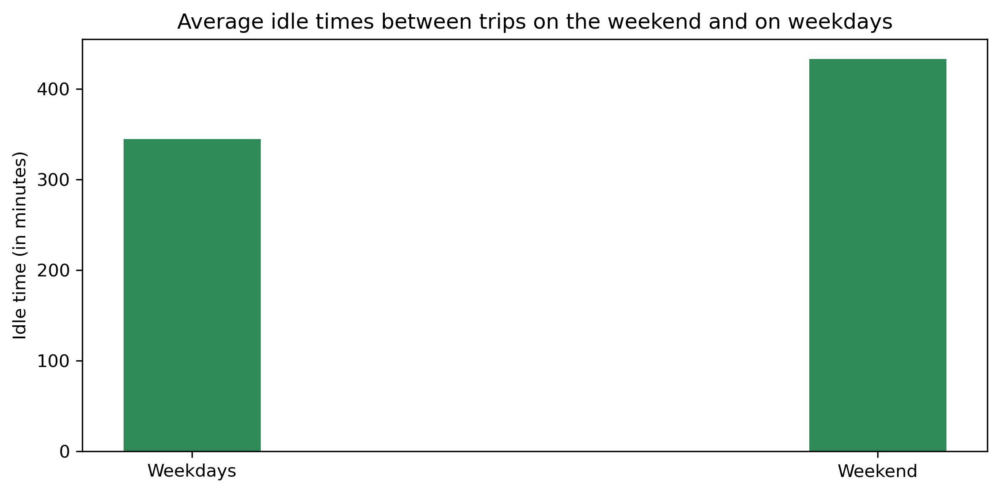

In [451]:
#plotting the average idle time per weekend or weekday
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,4), dpi=300)

name = ['Weekdays', 'Weekend']
ax.bar(name,idle_time_weekend['idle_time'], width=0.2, color='seagreen')

ax.set_xlabel('')
ax.set_ylabel('Idle time (in minutes)')
ax.set_title('Average idle times between trips on the weekend and on weekdays')

fig.tight_layout()

plt.savefig('Data/Visualizations/idle_times_weekend.png')
plt.show()

### Average idle times per Hexagons

In [299]:
def mean_idle_time_in_hex(data, resolution=9): 
    
    # creating geodataframe of the dataframe    
    geometry = [Point(xy) for xy in zip(data['longitude_start'], data['latitude_start'])]
    gdf_trips = geopandas.GeoDataFrame(data, crs='epsg:4326', geometry=geometry)
    gdf_trips.drop('index_right', inplace=True, axis=1)
    
    # join with hexagons 
    df_geos = hexForBonn(resolution=resolution) #create hexagons for bonn 
    gdf_trips_per_location = geopandas.sjoin(df_geos, gdf_trips, how='inner', op='contains')
    gdf_trips_per_location.reset_index(inplace=True)
    gdf_trips_per_location = gdf_trips_per_location.rename(columns={'h3_hex_id_left': 'h3_hex_id'})
    
    # group by hex_id and count the mean of the idle times per hexagons
    gdf_idle_time_per_location = gdf_trips_per_location.groupby("h3_hex_id").mean().reset_index()
    
    # selecting relevant columns
    gdf_idle_time_per_location = gdf_idle_time_per_location[['h3_hex_id', 'idle_time']]
        
    # add geometry column again and save the file as GeoJSON
    gdf_idle_time_per_location_geo = gdf_idle_time_per_location.merge(gdf_trips_per_location, on='h3_hex_id')
    gdf_idle_time_per_location_geo = gdf_idle_time_per_location_geo[['h3_hex_id', 'idle_time_x', 'geometry']]
    gdf_idle_time_per_location_geo = gdf_idle_time_per_location_geo.drop_duplicates()
    gdf_idle_time_per_location_geo['idle_time_x'] = round(gdf_idle_time_per_location_geo['idle_time_x'],2)
    gdf_idle_time_per_location_geo = geopandas.GeoDataFrame(gdf_idle_time_per_location_geo)
    gdf_idle_time_per_location_geo.to_file('data/idle_time_geo.geojson', driver='GeoJSON')
    
    # returns 2 geodataframe (hexagons for bonn / idle times per hexagon)
    return df_geos, gdf_idle_time_per_location

# returns choropleth 
def choropleth_mean_idle_time_per_hex(data, hex_resolution=8):
    df_geos, trips = mean_idle_time_in_hex(data, hex_resolution) # calls functions above 
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11.2,min_zoom=10)
    folium.Choropleth(geo_data="data/hex.geojson",
                      data=trips,
                      columns=["h3_hex_id","idle_time"],
                      key_on="properties.h3_hex_id",
                      fill_color='Reds',
                      fill_opacity=0.7,
                      line_opacity=0.5,
                      line_weight=1,
                      line_color='black',
                      legend_name='Mean idle time per hexagon').add_to(m)    
    
    # show mean idle time per hexagon by adding a GeoJsonTooltip
    folium.GeoJson('data/idle_time_geo.geojson',
                  style_function = lambda feature:{'color': 'black', 'weight':0.01, 'fillOpacity': 0.01},
                  highlight_function = lambda x: {'weight': 2, 'color':'black', 'fillOpacity': 0.5},
                  tooltip=folium.features.GeoJsonTooltip(fields=['h3_hex_id', 'idle_time_x'], aliases=['Hexagon ID:', 'Mean of the idle time in minutes:'])
                  ).add_to(m)
    
    
    return m 


In [302]:
m = choropleth_mean_idle_time_per_hex(trips, 7)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_hexagon7.html')
m

In [301]:
m = choropleth_mean_idle_time_per_hex(trips, 8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_hexagon8.html')
m

In [300]:
m = choropleth_mean_idle_time_per_hex(trips, 9)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_hexagon9.html')
m

##### Comparison between the average idle times on Monday and Sunday in Summer and in Winter

Mondays in Summer:

In [303]:
#Average idle time on Mondays in June
m = choropleth_mean_idle_time_per_hex(trips_mon_06, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time on Mondays in June per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_Monday_June_hexagon8.html')
m

Mondays in Winter:

In [304]:
#Average idle time on Mondays in December
m = choropleth_mean_idle_time_per_hex(trips_mon_12, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time on Mondays in December per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_Monday_December_hexagon8.html')
m

Sundays in Summer:

In [305]:
#Average idle time on Sundays in June
m = choropleth_mean_idle_time_per_hex(trips_sun_06, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time on Sundays in June per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_Sunday_June_hexagon8.html')
m

Sundays in Winter:

In [306]:
#Mean idle time on Sundays in December
m = choropleth_mean_idle_time_per_hex(trips_sun_12, hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time on Sundays in December per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_Sunday_December_hexagon8.html')
m

### Average idle times per Stations

In [322]:
#Filtering for started trips at stations
trips_stations_start = trips[(trips.p_spot_start == True)]
trips_stations_start.drop(list(trips_stations_start.filter(regex='end')), axis=1, inplace=True)

Bonn = [50.733334,7.100000]
start_stations = trips_stations_start
start_stations = start_stations[(start_stations.p_spot_start == True)]

start_stations['datetime_start'] = pd.to_datetime(start_stations['datetime_start'])
start_stations = start_stations.set_index('datetime_start')
start_stations['type'] = 'station'

# Aggregate number of trips for each start station by hour of the day
start = start_stations.pivot_table(
    index=['p_uid_start',
           'latitude_start',
           'longitude_start',
           start_stations.index.hour],
    columns='type',
    #Calculating the mean of the idle time
    aggfunc={'idle_time': np.mean}).reset_index()

# Rename the columns
start.columns = ['station_id', 'lat', 'lon', 'hour', 'mean']

# Define the color
start['fillColor'] = '#53c688'

# The stations with less than one bike
# will have a different color
start.loc[start['mean'] < 100, 'fillColor'] = '#586065'
# The stations with medium bikes have also a different color
start.loc[start['mean'] > 300, 'fillColor'] = '#f7ce00'
# those with many bikes are red
start.loc[start['mean'] > 500, 'fillColor'] = '#a82d2d'
# those with more than 20 are pink
start.loc[start['mean'] > 700, 'fillColor'] = '#fc03f4'

# as if now there doesn't seem to be a super easy way to implement that the radius stops at a small number like 25
# so the huge values of over 800 minutes will just be set to 800 this way
c = np.array(start['mean'].values.tolist())
start['mean'] = np.where(c > 800, 800, c).tolist()

# function to create the map features
def create_geojson_features(df):
    features = []
    # first take the geopgrahical data as points on a map defined by the row coordinates
    for _, row in df.iterrows():
        feature = {
            'type': 'Feature',
            'geometry': {
                'type': 'Point',
                'coordinates': [row['lon'], row['lat']]
            },
            # take properties for the animation, hour value for time, fill color is given for the cicle and defined
            # based on the amount of counts of bikes and the radius for the circle is also based on the count value
            'properties': {
                'time': pd.to_datetime(row['hour'], unit='h').__str__(),
                'style': {'color': ''},
                'icon': 'circle',
                'iconstyle': {
                    'fillColor': row['fillColor'],
                    'fillOpacity': 0.8,
                    'stroke': 'true',
                    'radius': row['mean']/50
                }
            }
        }
        features.append(feature)
    return features

start_geojson = create_geojson_features(start)

# map which shows the average idle time per hour over the day
# taken was the mean of the idle times per hour
m = folium.Map(location=Bonn, 
                  tiles='cartodbpositron',
                  keep_in_front=False,
                  zoom_start=12)

TimestampedGeoJson(start_geojson,
                   period='PT1H',
                   duration='PT1M',
                   transition_time=1000,
                   auto_play=True,
                   date_options='HH:mm:ss').add_to(m)

#mark University of Bonn
folium.Marker([50.72745325515178, 7.085836360350935], popup='<b>University of Bonn</b>', icon=folium.Icon(color='blue')).add_to(m)

#mark Bonn UN Campus station
folium.Marker([50.714633, 7.118333], popup='<b>Bonn - UN Campus station</b>', icon=folium.Icon(color='green')).add_to(m)
    
#mark Bonn Bahnhof Mehlem
folium.Marker([50.669060, 7.181750], popup='<b>Bahnhof Mehlem</b>', icon=folium.Icon(color='orange')).add_to(m)
    
#mark Bonn Mensa University of Bonn
folium.Marker([50.729050, 7.105150], popup='<b>Mensa University of Bonn</b>', icon=folium.Icon(color='purple')).add_to(m)

#Save map as html
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Average Idle Time per Station per Hour of the Day</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Idle_time_station_hour.html')

#Show map
m

## Start locations
Are there any locations which are more frequently used to start the trips from than other locations?

### Looking at all possible start locations in Bonn

In [328]:
def start_trips_in_hex(resolution=9): 
    
    # creating geodataframe of trips_per_station    
    geometry = [Point(xy) for xy in zip(trips['longitude_start'], trips['latitude_start'])]
    gdf_trips_start = geopandas.GeoDataFrame(trips, crs='epsg:4326', geometry=geometry)
    gdf_trips_start.drop('index_right', inplace=True, axis=1)
    
    # join with hexagons 
    df_geos = hexForBonn(resolution=resolution) #create hexagons for bonn 
    gdf_trips_start = geopandas.sjoin(df_geos, gdf_trips_start, how='inner', op='contains')
    gdf_trips_start.reset_index(inplace=True)
    
    # group by hex_id and sum up all trips per hexagons
    gdf_trips_start = gdf_trips_start.groupby("h3_hex_id_left").count()
    gdf_trips_start.reset_index(inplace=True)
    gdf_trips_start = gdf_trips_start.rename(columns={'h3_hex_id_left':'h3_hex_id', 'geometry_y':'geometry'})
    
    # add geometry column again and save the file as GeoJSON
    gdf_trips_start_geo =  gdf_trips_start.merge(df_geos, on='h3_hex_id')
    gdf_trips_start_geo = gdf_trips_start_geo[['h3_hex_id', 'index', 'geometry_y']]
    gdf_trips_start_geo = gdf_trips_start_geo.rename(columns={'geometry_y':'geometry'})
    gdf_trips_start_geo = gdf_trips_start_geo.drop_duplicates()
    gdf_trips_start_geo = geopandas.GeoDataFrame(gdf_trips_start_geo)
    gdf_trips_start_geo.to_file('data/trips_start_geo.geojson', driver='GeoJSON')
    
    # returns 2 geodataframe (hexagons for bonn / started trips per hexagons)
    return df_geos, gdf_trips_start

# returns choropleth 
def choropleth_start_trip_amounts_per_hex(hex_resolution=8):
    df_geos, trips = start_trips_in_hex(hex_resolution) # calls functions above 
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11.2,min_zoom=10)
    folium.Choropleth(geo_data="data/hex.geojson",
                      data=trips,
                      columns=["h3_hex_id","index"],
                      key_on="properties.h3_hex_id",
                      fill_color='Reds',
                      fill_opacity=0.7,
                      line_opacity=0.5,
                      line_weight=1,
                      line_color='black',
                      legend_name='Number of bookings per hexagon').add_to(m)
    
    # show the amount of trips started per hexagon by adding a GeoJsonTooltip
    folium.GeoJson('data/trips_start_geo.geojson',
                  style_function = lambda feature:{'color': 'black', 'weight':0.01, 'fillOpacity': 0.01},
                  highlight_function = lambda x: {'weight': 2, 'color':'black', 'fillOpacity': 0.5},
                  tooltip=folium.features.GeoJsonTooltip(fields=['h3_hex_id', 'index'], aliases=['Hexagon ID:', 'Number of bookings: '])
                  ).add_to(m)
    
    #mark University of Bonn
    folium.Marker([50.72745325515178, 7.085836360350935], popup='<b>University of Bonn</b>', icon=folium.Icon(color='blue')).add_to(m)
    
    #mark Bonn central station
    folium.Marker([50.732360, 7.097010], popup='<b>Bonn central station</b>', icon=folium.Icon(color='green')).add_to(m)

    return m 

In [331]:
m = choropleth_start_trip_amounts_per_hex(hex_resolution=7)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of started Trips per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Started_trips_hexagon7.html')
m

In [332]:
m = choropleth_start_trip_amounts_per_hex(hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of started Trips per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Started_trips_hexagon8.html')
m

In [333]:
m = choropleth_start_trip_amounts_per_hex(hex_resolution=9)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of started Trips per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Started_trips_hexagon9.html')
m

### Looking at the fixed stations

In [334]:
#Filtering for started trips at fixed stations
stations_start = trips[trips['p_spot_start'] == True]

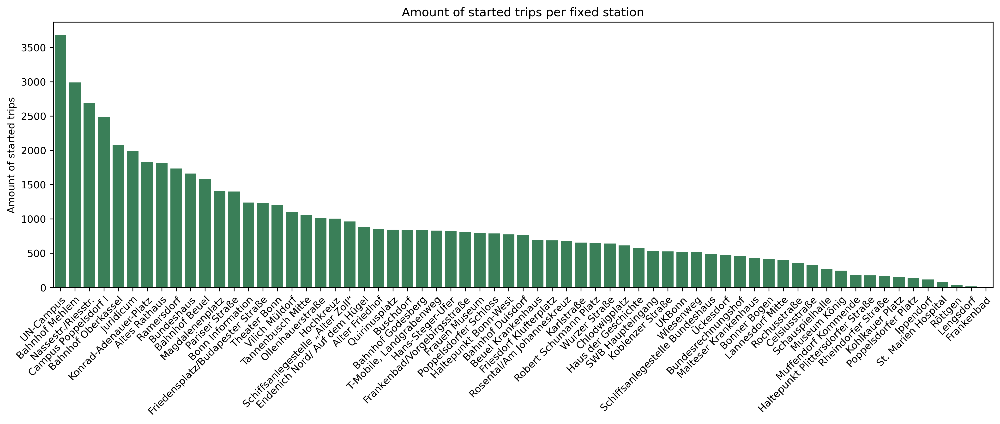

In [441]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 6), dpi=300)
sns.countplot(stations_start['p_name_start'], order=stations_start['p_name_start'].value_counts().index, ax=ax, color='seagreen')

ax.set_ylabel('Amount of started trips')
ax.set_xlabel('')
ax.set_title("Amount of started trips per fixed station")
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

fig.tight_layout()

plt.savefig('Data/Visualizations/Started_trips_station.png')
plt.show()

In [345]:
def trips_per_stations_in_hex(resolution, trips): 
    
    trips["count"] = 1 
    trips = trips[(trips['p_spot_start']) & (trips['p_spot_end'] != 0)] # filter on official stations 
    
    # group on stations and sum trips  
    trips_per_station = trips.groupby(["latitude_start", "longitude_start", "p_name_start"]).sum()[["count"]]
    trips_per_station.reset_index(inplace=True)
    trips_per_station.rename(columns={"latitude_start":"latitude", 
                                      "longitude_start":"longitude", 
                                      "p_name_start":"station_name",
                                      "count":"trips"}, inplace=True)
    
    # creating geodataframe of trips_per_station    
    geometry = [Point(xy) for xy in zip(trips_per_station['longitude'], trips_per_station['latitude'])]
    gdf_trips_per_station = geopandas.GeoDataFrame(trips_per_station, crs='epsg:4326', geometry=geometry)
    # join with hexagons 
    df_geos = hexForBonn(resolution=resolution) #create hexagons for bonn 
    gdf_trips_per_station = geopandas.sjoin(df_geos, gdf_trips_per_station, how='inner', op='contains')
    gdf_trips_per_station.reset_index(inplace=True)
    
    # group by hex_id and sum up all trips per hexagons
    gdf_trips_per_station = gdf_trips_per_station.groupby("h3_hex_id").sum()
    gdf_trips_per_station.reset_index(inplace=True
                                     )
    # returns 2 geodataframe (hexagons for bonn / trips_per_hexagons)
    return df_geos, gdf_trips_per_station

# returns choropleth 
def choropleth_trip_amounts_per_hex(hex_resolution, trips):
    df_geos, trips = trips_per_stations_in_hex(hex_resolution, trips) # calls functions above 
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11.2,min_zoom=10)
    folium.Choropleth(geo_data="data/hex.geojson",
                      data=trips,
                      columns=["h3_hex_id","trips"],
                      key_on="properties.h3_hex_id",
                      fill_color='Reds',
                      fill_opacity=0.7,
                      line_opacity=0.5,
                      line_weight=1,
                      line_color='black',
                      legend_name='Number of bookings per hexagon').add_to(m)    
    

    return m 

In [346]:
# with the parameter "hex_resolution" you can vary the size of the hexagons 
m = choropleth_trip_amounts_per_hex(hex_resolution=8, trips=trips)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of started Trips at fixed Stations per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Started_trips_stations_hexagon8.html')
m

## End locations
Are there any locations which are more frequently used to park a bike than others?

### Looking at all possible end locations in Bonn 

In [355]:
def end_trips_in_hex(resolution): 
    
    # creating geodataframe of trips_per_station    
    geometry = [Point(xy) for xy in zip(trips['longitude_end'], trips['latitude_end'])]
    gdf_trips_end = geopandas.GeoDataFrame(trips, crs='epsg:4326', geometry=geometry)
    gdf_trips_end.drop('index_right', inplace=True, axis=1)
    
    # join with hexagons 
    df_geos = hexForBonn(resolution=resolution) #create hexagons for bonn 
    gdf_trips_end = geopandas.sjoin(df_geos, gdf_trips_end, how='inner', op='contains')
    gdf_trips_end.reset_index(inplace=True)
    
    # group by hex_id and sum up all trips per hexagons
    gdf_trips_end = gdf_trips_end.groupby("h3_hex_id_left").count()
    gdf_trips_end.reset_index(inplace=True)
    gdf_trips_end = gdf_trips_end.rename(columns={'h3_hex_id_left':'h3_hex_id', 'geometry_y':'geometry'})
    
    # add geometry column again and save the file as GeoJSON
    gdf_trips_end_geo =  gdf_trips_end.merge(df_geos, on='h3_hex_id')
    gdf_trips_end_geo = gdf_trips_end_geo[['h3_hex_id', 'index', 'geometry_y']]
    gdf_trips_end_geo = gdf_trips_end_geo.rename(columns={'geometry_y':'geometry'})
    gdf_trips_end_geo = gdf_trips_end_geo.drop_duplicates()
    gdf_trips_end_geo = geopandas.GeoDataFrame(gdf_trips_end_geo)
    gdf_trips_end_geo.to_file('data/trips_end_geo.geojson', driver='GeoJSON')
    
    # returns 2 geodataframes (hexagons for bonn / trips_per_hexagons)
    return df_geos, gdf_trips_end

# returns choropleth 
def choropleth_end_trip_amounts_per_hex(hex_resolution):
    df_geos, trips = end_trips_in_hex(hex_resolution) # calls functions above 
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11.2,min_zoom=10)
    
    folium.Choropleth(geo_data="data/hex.geojson",
                      data=trips,
                      columns=["h3_hex_id","index"],
                      key_on="properties.h3_hex_id",
                      fill_color='Reds',
                      fill_opacity=0.7,
                      line_opacity=0.5,
                      line_weight=1,
                      line_color='black',
                      legend_name='Number of bookings per hexagon').add_to(m)    
   
    folium.GeoJson('data/trips_start_geo.geojson',
                  style_function = lambda feature:{'color': 'black', 'weight':0.01, 'fillOpacity': 0.01},
                  highlight_function = lambda x: {'weight': 2, 'color':'black', 'fillOpacity': 0.5},
                  tooltip=folium.features.GeoJsonTooltip(fields=['h3_hex_id', 'index'], aliases=['Hexagon ID:', 'Number of bookings: '])
                  ).add_to(m)
    
    #mark University of Bonn
    folium.Marker([50.72745325515178, 7.085836360350935], popup='<b>University of Bonn</b>', icon=folium.Icon(color='blue')).add_to(m)
    
    #mark Bonn central station
    folium.Marker([50.732360, 7.097010], popup='<b>Bonn central station</b>', icon=folium.Icon(color='green')).add_to(m)
    
    return m 
    

In [356]:
m = choropleth_end_trip_amounts_per_hex(hex_resolution=7)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of ended Trips per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Ended_trips_hexagon7.html')
m

In [357]:
m = choropleth_end_trip_amounts_per_hex(hex_resolution=8)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of ended Trips per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Ended_trips_hexagon8.html')
m

In [358]:
m = choropleth_end_trip_amounts_per_hex(hex_resolution=9)
title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of ended Trips per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Ended_trips_hexagon9.html')
m

### Looking at the fixed stations in Bonn 

In [359]:
#Filtering for ended trips at fixed stations
stations_end = trips[trips['p_spot_end'] == True]

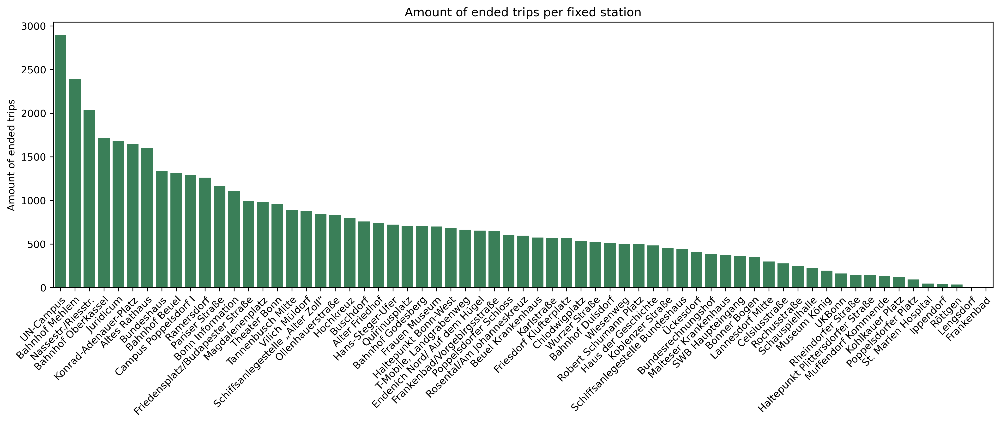

In [440]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 6), dpi=300)
sns.countplot(stations_end['p_name_end'], order=stations_end['p_name_end'].value_counts().index, ax=ax, color='seagreen')

ax.set_ylabel('Amount of ended trips')
ax.set_xlabel('')
ax.set_title("Amount of ended trips per fixed station")
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

fig.tight_layout()

plt.savefig('Data/Visualizations/Ended_trips_station.png')
plt.show()

In [363]:
def ended_trips_per_stations_in_hex(resolution): 
    trips["count"] = 1 
    trips_station = trips[(trips['p_spot_start']) & (trips['p_spot_end'] != 0)] # filter on official stations 
    
    # group on stations and sum trips  
    ended_trips_per_station = trips_station.groupby(["latitude_end", "longitude_end", "p_name_end"]).sum()[["count"]]
    ended_trips_per_station.reset_index(inplace=True)
    ended_trips_per_station.rename(columns={"latitude_end":"latitude", 
                                      "longitude_end":"longitude", 
                                      "p_name_end":"station_name",
                                      "count":"trips"}, inplace=True)
    
    # creating geodataframe of trips_per_station    
    geometry = [Point(xy) for xy in zip(ended_trips_per_station['longitude'], ended_trips_per_station['latitude'])]
    gdf_ended_trips_per_station = geopandas.GeoDataFrame(ended_trips_per_station, crs='epsg:4326', geometry=geometry)
    # join with hexagons 
    df_geos = hexForBonn(resolution=resolution) #create hexagons for bonn 
    gdf_ended_trips_per_station = geopandas.sjoin(df_geos, gdf_ended_trips_per_station, how='inner', op='contains')
    gdf_ended_trips_per_station.reset_index(inplace=True)
    
    # group by hex_id and sum up all trips per hexagons
    gdf_ended_trips_per_station = gdf_ended_trips_per_station.groupby("h3_hex_id").sum()
    gdf_ended_trips_per_station.reset_index(inplace=True)
    
    # returns 2 geodataframe (hexagons for bonn / trips_per_hexagons)
    return df_geos, gdf_ended_trips_per_station

# returns choropleth 
def choropleth_ended_trips_per_station_hex(hex_resolution):
    df_geos, trips = ended_trips_per_stations_in_hex(hex_resolution) # calls functions above 
    m = folium.Map(location = [50.7323,7.1847], zoom_start=11.2,min_zoom=10)
    folium.Choropleth(geo_data="data/hex.geojson",
                      data=trips,
                      columns=["h3_hex_id","trips"],
                      key_on="properties.h3_hex_id",
                      fill_color='Reds',
                      fill_opacity=0.7,
                      line_opacity=0.5,
                      line_weight=1,
                      line_color='black',
                      legend_name='Number of bookings per hexagon').add_to(m)    
    

    return m 

In [364]:
# with the parameter "hex_resolution" you can vary the size of the hexagons 
m = choropleth_ended_trips_per_station_hex(hex_resolution=8)

title_html = '''
             <h3 align="center" style="font-size:20px"><b>Amount of ended Trips at fixed Stations per Hexagon</b></h3>
             '''
m.get_root().html.add_child(folium.Element(title_html))
m.save('Data/Visualizations/Ended_trips_hexagon9.html')
m

# 3. Visualization of the amount of bookings regarding different temporal resolution

In this section we visualize the demand of bikes comparing the different days of the week and the months.

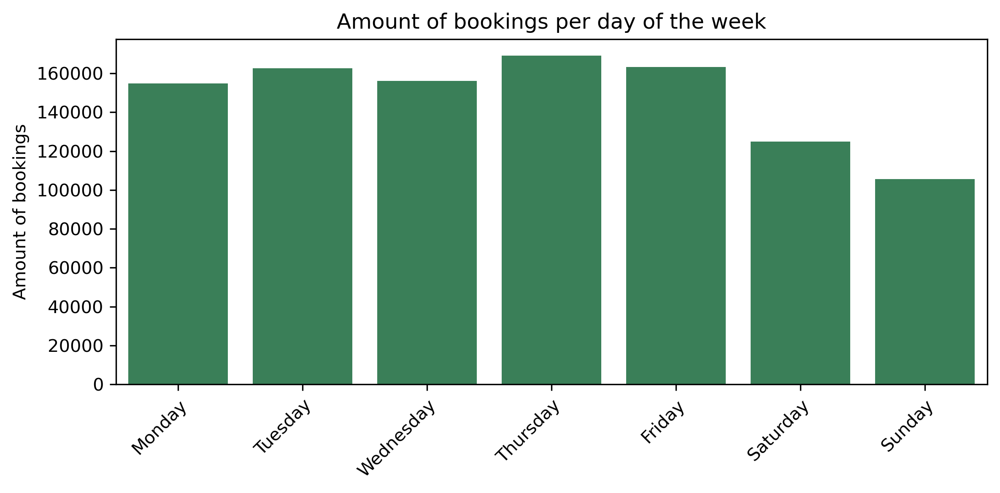

In [423]:
#plotting the amount of bookings per day of the week
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,4), dpi=300)

sns.countplot(trips['weekday'], ax=ax, color="seagreen")
days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

ax.set_xticklabels(days)
ax.set_xlabel('')
ax.set_ylabel('Amount of bookings')
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
ax.set_title('Amount of bookings per day of the week')

fig.tight_layout()

plt.savefig('Data/Visualizations/Bookings_weekday.png')
plt.show()

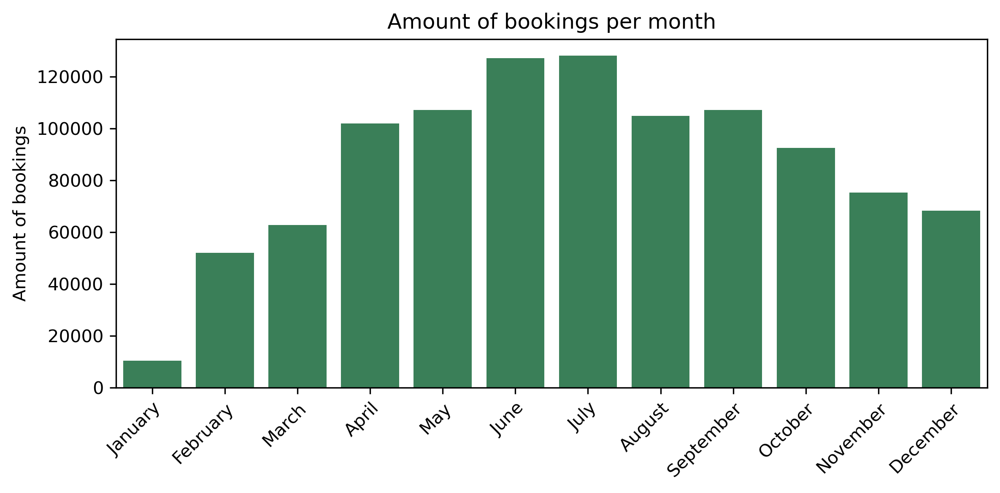

In [424]:
#plotting the amount of bookings per month
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8,4), dpi=300)

sns.countplot(trips['month'], ax=ax, color="seagreen")

months = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
ax.set_xticklabels(months)

ax.set_xlabel('')
ax.set_ylabel('Amount of bookings')
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")
plt.title('Amount of bookings per month')

fig.tight_layout()

plt.savefig('Data/Visualizations/Bookings_month.png')
plt.show()